In [1]:
import sys
import random
import warnings
import numpy as np

from glob import glob
from tqdm import tqdm
import matplotlib.pyplot as plt
from IPython import display
import cv2
import os
import random
import time
import shutil
from sklearn.utils import shuffle
import glob
%matplotlib inline

from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Dropout, Lambda
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, BatchNormalization, LeakyReLU, Add
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import concatenate
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import backend as K

IMG_WIDTH = 512
IMG_HEIGHT = 512
IMG_CHANNELS = 3
TRAIN_PATH = "./Drive/training/images/"
TEST_PATH = "./Drive/training/1st_manual/"
FINAL_TEST_PATH = "./Drive/test/images/"

dir_path = ""

warnings.filterwarnings("ignore", category = UserWarning, module = "skimage")
seed = 42
random.seed = seed
np.random.seed = seed

print(np.version.version)

2021-08-19 14:27:05.651343: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


1.19.5


In [2]:
# Build U-Net model
inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
s = Lambda(lambda x: x / 255) (inputs)

c1 = Conv2D(32, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (s)
c1 = BatchNormalization()(c1)
c1 = Dropout(0.1) (c1)
c1 = Conv2D(32, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c1)
c1 = BatchNormalization()(c1)
p1 = MaxPooling2D((2, 2)) (c1)

c2 = Conv2D(64, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (p1)
c2 = BatchNormalization()(c2)
c2 = Dropout(0.1) (c2)
c2 = Conv2D(64, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c2)
c2 = BatchNormalization()(c2)
p2 = MaxPooling2D((2, 2)) (c2)

c3 = Conv2D(128, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (p2)
c3 = BatchNormalization()(c3)
c3 = Dropout(0.2) (c3)
c3 = Conv2D(128, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c3)
c3 = BatchNormalization()(c3)
p3 = MaxPooling2D((2, 2)) (c3)

c4 = Conv2D(256, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (p3)
c4 = BatchNormalization()(c4)
c4 = Dropout(0.2) (c4)
c4 = Conv2D(256, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c4)
c4 = BatchNormalization()(c4)
p4 = MaxPooling2D(pool_size=(2, 2)) (c4)

c5 = Conv2D(512, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (p4)
c5 = BatchNormalization()(c5)
c5 = Dropout(0.3) (c5)
c5 = Conv2D(512, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c5)
c5 = BatchNormalization()(c5)

u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding="same") (c5)
u6 = concatenate([u6, c4])
c6 = Conv2D(256, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (u6)
c6 = BatchNormalization()(c6)
c6 = Dropout(0.2) (c6)
c6 = Conv2D(256, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c6)
c6 = BatchNormalization()(c6)

u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding="same") (c6)
u7 = concatenate([u7, c3])
c7 = Conv2D(128, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (u7)
c7 = BatchNormalization()(c7)
c7 = Dropout(0.2) (c7)
c7 = Conv2D(128, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c7)
c7 = BatchNormalization()(c7)

u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding="same") (c7)
u8 = concatenate([u8, c2])
c8 = Conv2D(64, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (u8)
c8 = BatchNormalization()(c8)
c8 = Dropout(0.1) (c8)
c8 = Conv2D(64, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c8)
c8 = BatchNormalization()(c8)

u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding="same") (c8)
u9 = concatenate([u9, c1], axis=3)
c9 = Conv2D(32, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (u9)
c9 = BatchNormalization()(c9)
c9 = Dropout(0.1) (c9)
c9 = Conv2D(32, (3, 3), activation="relu", kernel_initializer="he_normal", padding="same") (c9)
c9 = BatchNormalization()(c9)

outputs = Conv2D(1, (1, 1), activation="sigmoid") (c9)

2021-08-19 14:27:06.459092: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-08-19 14:27:06.527893: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-19 14:27:06.530229: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1070 computeCapability: 6.1
coreClock: 1.86GHz coreCount: 15 deviceMemorySize: 7.91GiB deviceMemoryBandwidth: 238.66GiB/s
2021-08-19 14:27:06.530351: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-08-19 14:27:06.540130: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2021-08-19 14:27:06.540337: I tensorflow/stream_executor/platform/de

In [3]:
# Get train and test IDs

def getPath(path, file):

    image_list = []

    for filename in glob.glob(path + "*" + file): #assuming gif

        image_list.append(filename)

    return image_list

train_ids = sorted(getPath(TRAIN_PATH, ".tif"))
test_ids = sorted(getPath(TEST_PATH, ".gif"))
final_test_ids = sorted(getPath(FINAL_TEST_PATH, ".tif"))

In [4]:
# Get and resize train images and masks
X_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
Y_train = np.zeros((len(train_ids), IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
print("Getting and resizing train images and masks ... ")

Getting and resizing train images and masks ... 


  0%|                                                                                                                                                                                                                                                      | 0/20 [00:00<?, ?it/s]

Dados : 
 ImagePath : ./Drive/training/images/21_training.tif

imagem dim : (512, 512, 3)


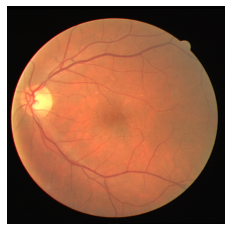

Dim Gr : (512, 512, 1)


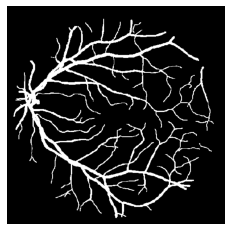

  5%|███████████▉                                                                                                                                                                                                                                  | 1/20 [00:00<00:04,  3.84it/s]

Dados : 
 ImagePath : ./Drive/training/images/22_training.tif

imagem dim : (512, 512, 3)


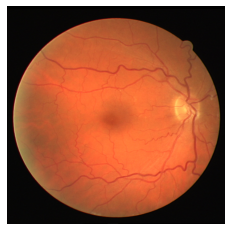

Dim Gr : (512, 512, 1)


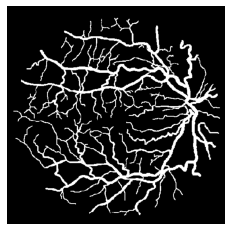

 10%|███████████████████████▊                                                                                                                                                                                                                      | 2/20 [00:00<00:04,  4.21it/s]

Dados : 
 ImagePath : ./Drive/training/images/23_training.tif

imagem dim : (512, 512, 3)


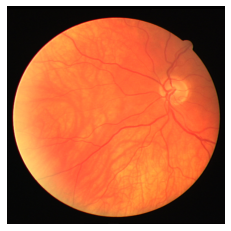

Dim Gr : (512, 512, 1)


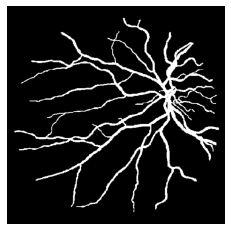

 15%|███████████████████████████████████▋                                                                                                                                                                                                          | 3/20 [00:00<00:03,  4.50it/s]

Dados : 
 ImagePath : ./Drive/training/images/24_training.tif

imagem dim : (512, 512, 3)


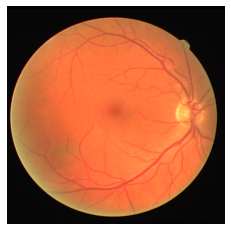

Dim Gr : (512, 512, 1)


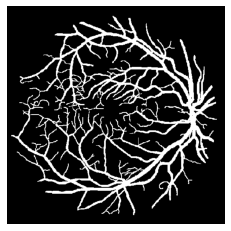

 20%|███████████████████████████████████████████████▌                                                                                                                                                                                              | 4/20 [00:00<00:03,  4.62it/s]

Dados : 
 ImagePath : ./Drive/training/images/25_training.tif

imagem dim : (512, 512, 3)


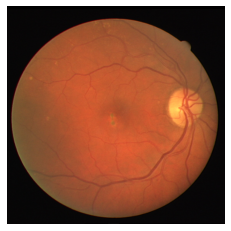

Dim Gr : (512, 512, 1)


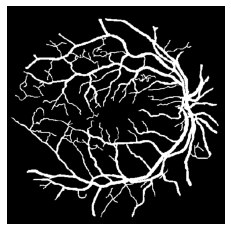

 25%|███████████████████████████████████████████████████████████▌                                                                                                                                                                                  | 5/20 [00:01<00:03,  4.64it/s]

Dados : 
 ImagePath : ./Drive/training/images/26_training.tif

imagem dim : (512, 512, 3)


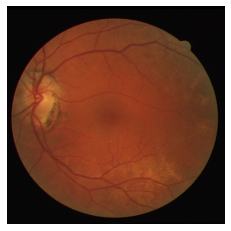

Dim Gr : (512, 512, 1)


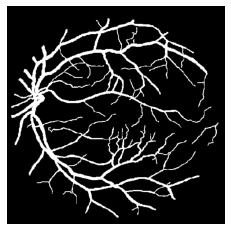

 30%|███████████████████████████████████████████████████████████████████████▍                                                                                                                                                                      | 6/20 [00:01<00:03,  4.28it/s]

Dados : 
 ImagePath : ./Drive/training/images/27_training.tif

imagem dim : (512, 512, 3)


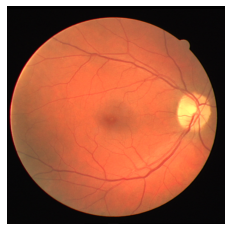

Dim Gr : (512, 512, 1)


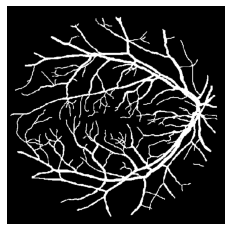

 35%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                          | 7/20 [00:01<00:03,  4.26it/s]

Dados : 
 ImagePath : ./Drive/training/images/28_training.tif

imagem dim : (512, 512, 3)


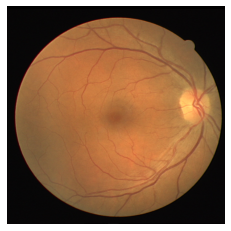

Dim Gr : (512, 512, 1)


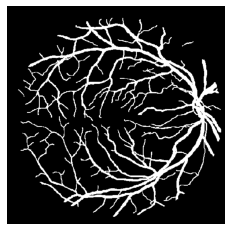

 40%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                              | 8/20 [00:01<00:02,  4.46it/s]

Dados : 
 ImagePath : ./Drive/training/images/29_training.tif

imagem dim : (512, 512, 3)


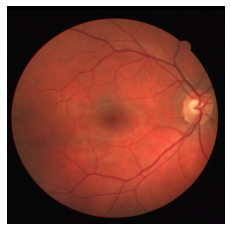

Dim Gr : (512, 512, 1)


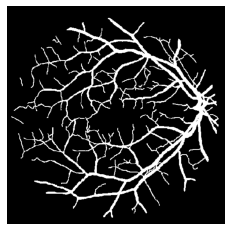

 45%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                   | 9/20 [00:02<00:02,  4.59it/s]

Dados : 
 ImagePath : ./Drive/training/images/30_training.tif

imagem dim : (512, 512, 3)


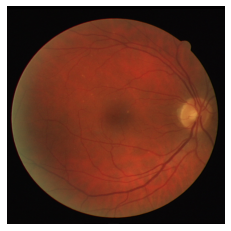

Dim Gr : (512, 512, 1)


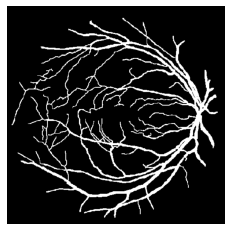

 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 10/20 [00:02<00:02,  4.60it/s]

Dados : 
 ImagePath : ./Drive/training/images/31_training.tif

imagem dim : (512, 512, 3)


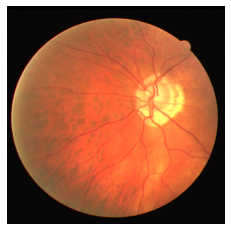

Dim Gr : (512, 512, 1)


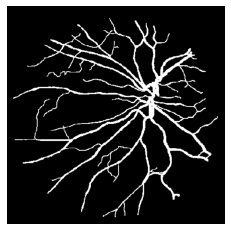

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 11/20 [00:02<00:01,  4.61it/s]

Dados : 
 ImagePath : ./Drive/training/images/32_training.tif

imagem dim : (512, 512, 3)


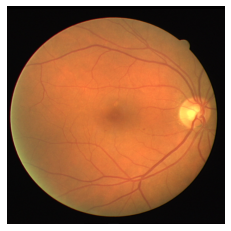

Dim Gr : (512, 512, 1)


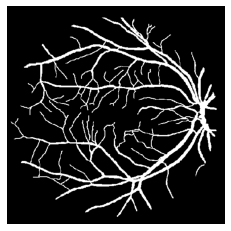

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 12/20 [00:02<00:01,  4.52it/s]

Dados : 
 ImagePath : ./Drive/training/images/33_training.tif

imagem dim : (512, 512, 3)


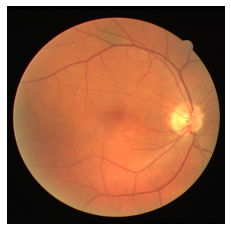

Dim Gr : (512, 512, 1)


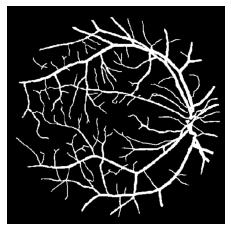

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 13/20 [00:02<00:01,  4.54it/s]

Dados : 
 ImagePath : ./Drive/training/images/34_training.tif

imagem dim : (512, 512, 3)


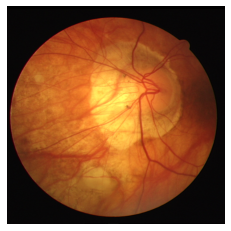

Dim Gr : (512, 512, 1)


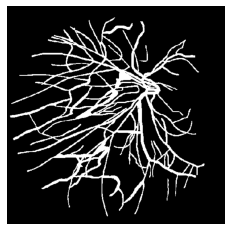

 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 14/20 [00:03<00:01,  4.58it/s]

Dados : 
 ImagePath : ./Drive/training/images/35_training.tif

imagem dim : (512, 512, 3)


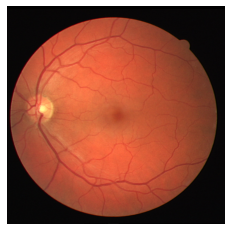

Dim Gr : (512, 512, 1)


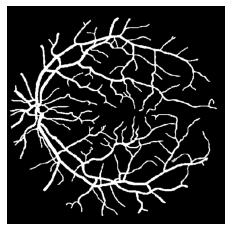

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 15/20 [00:03<00:01,  4.67it/s]

Dados : 
 ImagePath : ./Drive/training/images/36_training.tif

imagem dim : (512, 512, 3)


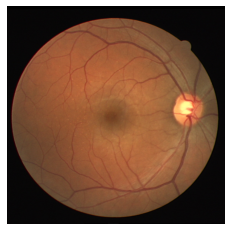

Dim Gr : (512, 512, 1)


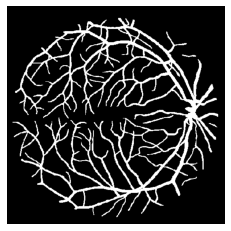

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 16/20 [00:03<00:00,  4.74it/s]

Dados : 
 ImagePath : ./Drive/training/images/37_training.tif

imagem dim : (512, 512, 3)


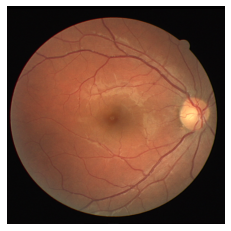

Dim Gr : (512, 512, 1)


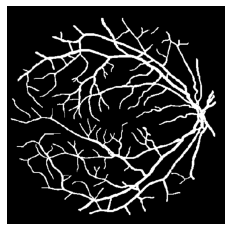

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 17/20 [00:03<00:00,  4.37it/s]

Dados : 
 ImagePath : ./Drive/training/images/38_training.tif

imagem dim : (512, 512, 3)


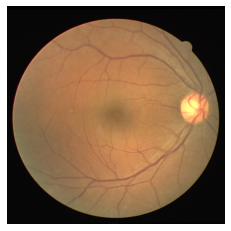

Dim Gr : (512, 512, 1)


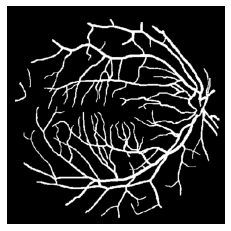

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 18/20 [00:03<00:00,  4.54it/s]

Dados : 
 ImagePath : ./Drive/training/images/39_training.tif

imagem dim : (512, 512, 3)


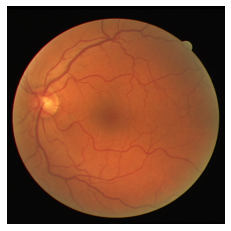

Dim Gr : (512, 512, 1)


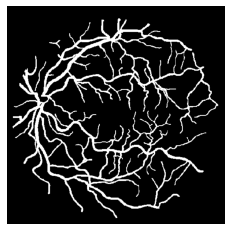

 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 19/20 [00:04<00:00,  4.50it/s]

Dados : 
 ImagePath : ./Drive/training/images/40_training.tif

imagem dim : (512, 512, 3)


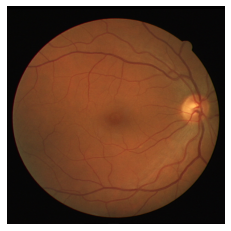

Dim Gr : (512, 512, 1)


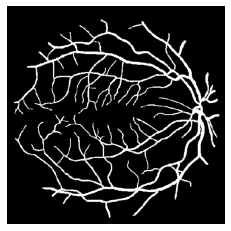

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:04<00:00,  4.52it/s]

Getting and resizing test images ... 



  0%|                                                                                                                                                                                                                                                      | 0/20 [00:00<?, ?it/s]

Dados : 
 ImagePath : ./Drive/test/images/01_test.tif

imagem dim : (512, 512, 3)


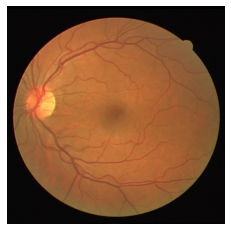

  5%|███████████▉                                                                                                                                                                                                                                  | 1/20 [00:00<00:02,  7.34it/s]

Dados : 
 ImagePath : ./Drive/test/images/02_test.tif

imagem dim : (512, 512, 3)


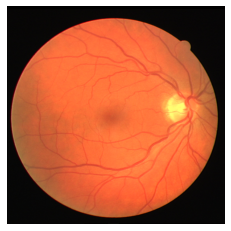

 10%|███████████████████████▊                                                                                                                                                                                                                      | 2/20 [00:00<00:02,  7.53it/s]

Dados : 
 ImagePath : ./Drive/test/images/03_test.tif

imagem dim : (512, 512, 3)


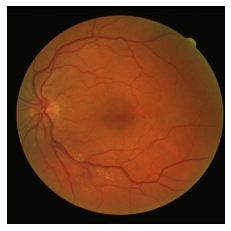

 15%|███████████████████████████████████▋                                                                                                                                                                                                          | 3/20 [00:00<00:02,  7.63it/s]

Dados : 
 ImagePath : ./Drive/test/images/04_test.tif

imagem dim : (512, 512, 3)


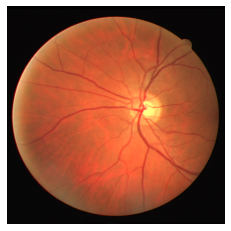

 20%|███████████████████████████████████████████████▌                                                                                                                                                                                              | 4/20 [00:00<00:02,  7.57it/s]

Dados : 
 ImagePath : ./Drive/test/images/05_test.tif

imagem dim : (512, 512, 3)


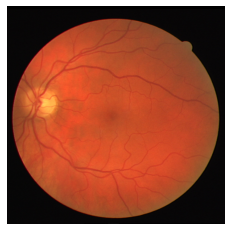

 25%|███████████████████████████████████████████████████████████▌                                                                                                                                                                                  | 5/20 [00:00<00:01,  7.54it/s]

Dados : 
 ImagePath : ./Drive/test/images/06_test.tif

imagem dim : (512, 512, 3)


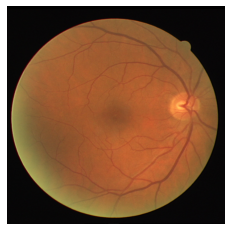

 30%|███████████████████████████████████████████████████████████████████████▍                                                                                                                                                                      | 6/20 [00:00<00:01,  7.53it/s]

Dados : 
 ImagePath : ./Drive/test/images/07_test.tif

imagem dim : (512, 512, 3)


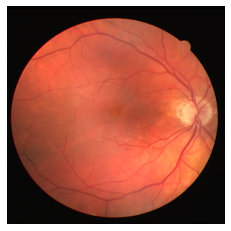

 35%|███████████████████████████████████████████████████████████████████████████████████▎                                                                                                                                                          | 7/20 [00:00<00:01,  7.54it/s]

Dados : 
 ImagePath : ./Drive/test/images/08_test.tif

imagem dim : (512, 512, 3)


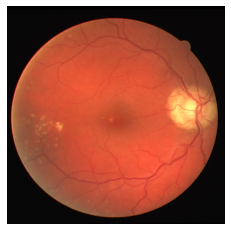

 40%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                                                                              | 8/20 [00:01<00:01,  7.53it/s]

Dados : 
 ImagePath : ./Drive/test/images/09_test.tif

imagem dim : (512, 512, 3)


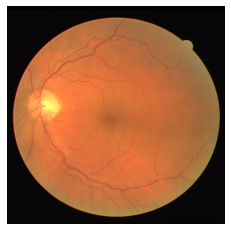

 45%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                   | 9/20 [00:01<00:01,  7.53it/s]

Dados : 
 ImagePath : ./Drive/test/images/10_test.tif

imagem dim : (512, 512, 3)


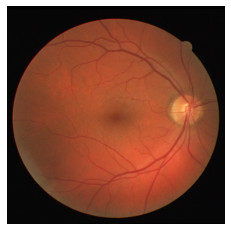

 50%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                                                                                      | 10/20 [00:01<00:01,  7.55it/s]

Dados : 
 ImagePath : ./Drive/test/images/11_test.tif

imagem dim : (512, 512, 3)


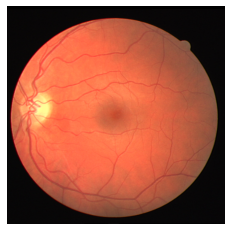

 55%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                                                                          | 11/20 [00:01<00:01,  7.49it/s]

Dados : 
 ImagePath : ./Drive/test/images/12_test.tif

imagem dim : (512, 512, 3)


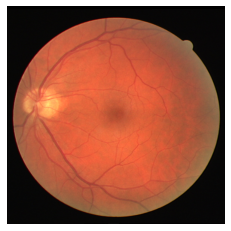

 60%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                                                              | 12/20 [00:01<00:01,  7.41it/s]

Dados : 
 ImagePath : ./Drive/test/images/13_test.tif

imagem dim : (512, 512, 3)


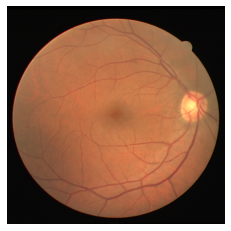

 65%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                   | 13/20 [00:01<00:00,  7.40it/s]

Dados : 
 ImagePath : ./Drive/test/images/14_test.tif

imagem dim : (512, 512, 3)


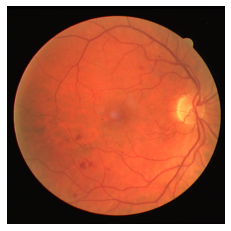

 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                                       | 14/20 [00:01<00:00,  7.40it/s]

Dados : 
 ImagePath : ./Drive/test/images/15_test.tif

imagem dim : (512, 512, 3)


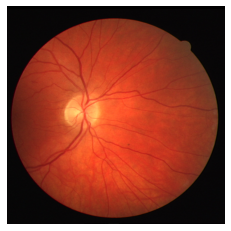

 75%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 15/20 [00:02<00:00,  6.41it/s]

Dados : 
 ImagePath : ./Drive/test/images/16_test.tif

imagem dim : (512, 512, 3)


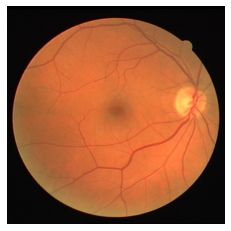

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                               | 16/20 [00:02<00:00,  6.75it/s]

Dados : 
 ImagePath : ./Drive/test/images/17_test.tif

imagem dim : (512, 512, 3)


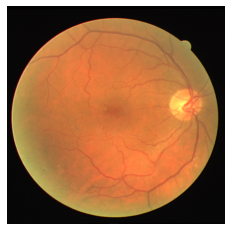

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                   | 17/20 [00:02<00:00,  6.97it/s]

Dados : 
 ImagePath : ./Drive/test/images/18_test.tif

imagem dim : (512, 512, 3)


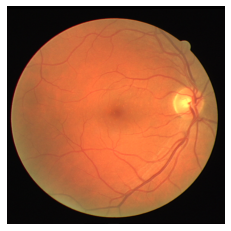

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 18/20 [00:02<00:00,  7.15it/s]

Dados : 
 ImagePath : ./Drive/test/images/19_test.tif

imagem dim : (512, 512, 3)


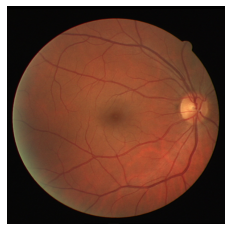

 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 19/20 [00:02<00:00,  7.25it/s]

Dados : 
 ImagePath : ./Drive/test/images/20_test.tif

imagem dim : (512, 512, 3)


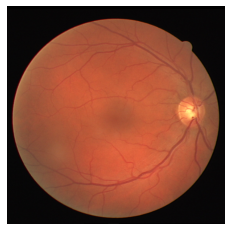

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:02<00:00,  7.31it/s]

Done!


In [5]:
import imageio
from tifffile import imread, imwrite
from skimage.transform import resize

sys.stdout.flush()
for n, id_ in tqdm(enumerate(train_ids), total=len(train_ids)):

    print("Dados : \n ImagePath : {}\n".format(id_))
    #image = Image.open(id_)
    image = imread(id_)[:,:,:IMG_CHANNELS]
    image = resize(image, (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS), mode="constant", preserve_range=True)

    print("imagem dim : {}".format(image.shape))
    X_train[n] = image

    plt.axis("off")
    plt.imshow(X_train[n])
    plt.show()

    gif = imageio.get_reader(test_ids[n], ".gif")
    groundtruth = []
    for frame in gif:

      groundtruth = frame

    groundtruth=np.where(groundtruth>0,1,0)
    mask = np.zeros((IMG_HEIGHT, IMG_WIDTH, 1), dtype=np.bool)
    
    #Expand individual mask dimensions
    mask_ = np.expand_dims(resize(groundtruth, (IMG_HEIGHT, IMG_WIDTH), mode="constant",
                                      preserve_range=True), axis=-1)

    mask = np.maximum(mask, mask_)
    Y_train[n] = mask

    print("Dim Gr : {}".format(mask.shape))
    
    plt.axis("off")
    plt.imshow(Y_train[n], cmap = plt.cm.gray)
    plt.show()

X_test = np.zeros((len(test_ids), IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS), dtype=np.uint8)
sizes_test = []
print("Getting and resizing test images ... ")
sys.stdout.flush()

for n, id_ in tqdm(enumerate(final_test_ids), total=len(final_test_ids)):

    print("Dados : \n ImagePath : {}\n".format(id_))
    image = imread(id_)[:,:,:IMG_CHANNELS]
    image = resize(image, (IMG_WIDTH, IMG_HEIGHT, IMG_CHANNELS), mode="constant", preserve_range=True)
    print("imagem dim : {}".format(image.shape))
    X_test[n] = image

    plt.axis("off")
    plt.imshow(X_test[n], cmap = plt.cm.gray)
    plt.show()

    sizes_test.append([image.shape[0], image.shape[1]])

print("Done!")

In [6]:
model = Model(inputs=[inputs], outputs=[outputs])
model.compile(optimizer="adam", loss="binary_crossentropy", metrics=["accuracy"])
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 512, 512, 3) 0                                            
__________________________________________________________________________________________________
lambda (Lambda)                 (None, 512, 512, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 512, 512, 32) 896         lambda[0][0]                     
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 512, 512, 32) 128         conv2d[0][0]                     
______________________________________________________________________________________________

In [7]:
# Fit model
earlystopper = EarlyStopping(patience=15, verbose=1)
checkpointer = ModelCheckpoint("model_unet_checkpoint.h5", verbose=1, save_best_only=True)
results = model.fit(X_train, Y_train, validation_split=0.1, batch_size=1, epochs=200,
                    callbacks=[checkpointer])
model.save("modelEffNetDrive.h5")

2021-08-19 14:27:15.062434: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:176] None of the MLIR Optimization Passes are enabled (registered 2)
2021-08-19 14:27:15.079466: I tensorflow/core/platform/profile_utils/cpu_utils.cc:114] CPU Frequency: 3999980000 Hz


Epoch 1/200


2021-08-19 14:27:16.570517: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudnn.so.8
2021-08-19 14:27:16.800899: I tensorflow/stream_executor/cuda/cuda_dnn.cc:359] Loaded cuDNN version 8101
2021-08-19 14:27:17.056714: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2021-08-19 14:27:17.230265: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublasLt.so.11


18/18 [==============================] - 6s 105ms/step - loss: 0.6492 - accuracy: 0.6601 - val_loss: 0.8313 - val_accuracy: 0.5151

Epoch 00001: val_loss improved from inf to 0.83130, saving model to model_unet_checkpoint.h5
Epoch 2/200
18/18 [==============================] - 2s 87ms/step - loss: 0.4675 - accuracy: 0.8795 - val_loss: 0.5224 - val_accuracy: 0.8724

Epoch 00002: val_loss improved from 0.83130 to 0.52241, saving model to model_unet_checkpoint.h5
Epoch 3/200
18/18 [==============================] - 2s 86ms/step - loss: 0.3720 - accuracy: 0.9182 - val_loss: 0.4280 - val_accuracy: 0.8743

Epoch 00003: val_loss improved from 0.52241 to 0.42798, saving model to model_unet_checkpoint.h5
Epoch 4/200
18/18 [==============================] - 2s 87ms/step - loss: 0.3214 - accuracy: 0.9291 - val_loss: 24.4330 - val_accuracy: 0.2292

Epoch 00004: val_loss did not improve from 0.42798
Epoch 5/200
18/18 [==============================] - 2s 88ms/step - loss: 0.2766 - accuracy: 0.9376 

18/18 [==============================] - 2s 88ms/step - loss: 0.0832 - accuracy: 0.9664 - val_loss: 0.1753 - val_accuracy: 0.9458

Epoch 00040: val_loss did not improve from 0.13049
Epoch 41/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0813 - accuracy: 0.9668 - val_loss: 0.1722 - val_accuracy: 0.9439

Epoch 00041: val_loss did not improve from 0.13049
Epoch 42/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0792 - accuracy: 0.9676 - val_loss: 0.1468 - val_accuracy: 0.9491

Epoch 00042: val_loss did not improve from 0.13049
Epoch 43/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0771 - accuracy: 0.9683 - val_loss: 0.1333 - val_accuracy: 0.9532

Epoch 00043: val_loss did not improve from 0.13049
Epoch 44/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0756 - accuracy: 0.9689 - val_loss: 0.1474 - val_accuracy: 0.9519

Epoch 00044: val_loss did not improve from 0.13049
Epoch 45/200
18/18 [==================

18/18 [==============================] - 2s 87ms/step - loss: 0.0379 - accuracy: 0.9840 - val_loss: 0.1754 - val_accuracy: 0.9555

Epoch 00082: val_loss did not improve from 0.11798
Epoch 83/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0378 - accuracy: 0.9841 - val_loss: 0.2240 - val_accuracy: 0.9498

Epoch 00083: val_loss did not improve from 0.11798
Epoch 84/200
18/18 [==============================] - 2s 88ms/step - loss: 0.0371 - accuracy: 0.9843 - val_loss: 0.1933 - val_accuracy: 0.9541

Epoch 00084: val_loss did not improve from 0.11798
Epoch 85/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0368 - accuracy: 0.9845 - val_loss: 0.1893 - val_accuracy: 0.9551

Epoch 00085: val_loss did not improve from 0.11798
Epoch 86/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0364 - accuracy: 0.9846 - val_loss: 0.1927 - val_accuracy: 0.9542

Epoch 00086: val_loss did not improve from 0.11798
Epoch 87/200
18/18 [==================

18/18 [==============================] - 2s 87ms/step - loss: 0.0247 - accuracy: 0.9895 - val_loss: 0.2177 - val_accuracy: 0.9573

Epoch 00124: val_loss did not improve from 0.11798
Epoch 125/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0250 - accuracy: 0.9895 - val_loss: 0.2107 - val_accuracy: 0.9576

Epoch 00125: val_loss did not improve from 0.11798
Epoch 126/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0247 - accuracy: 0.9896 - val_loss: 0.2305 - val_accuracy: 0.9538

Epoch 00126: val_loss did not improve from 0.11798
Epoch 127/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0243 - accuracy: 0.9898 - val_loss: 0.2202 - val_accuracy: 0.9566

Epoch 00127: val_loss did not improve from 0.11798
Epoch 128/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0240 - accuracy: 0.9899 - val_loss: 0.2208 - val_accuracy: 0.9559

Epoch 00128: val_loss did not improve from 0.11798
Epoch 129/200
18/18 [=============

18/18 [==============================] - 2s 87ms/step - loss: 0.0185 - accuracy: 0.9923 - val_loss: 0.2712 - val_accuracy: 0.9525

Epoch 00166: val_loss did not improve from 0.11798
Epoch 167/200
18/18 [==============================] - 2s 88ms/step - loss: 0.0184 - accuracy: 0.9924 - val_loss: 0.2455 - val_accuracy: 0.9569

Epoch 00167: val_loss did not improve from 0.11798
Epoch 168/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0185 - accuracy: 0.9923 - val_loss: 0.2292 - val_accuracy: 0.9585

Epoch 00168: val_loss did not improve from 0.11798
Epoch 169/200
18/18 [==============================] - 2s 86ms/step - loss: 0.0182 - accuracy: 0.9924 - val_loss: 0.2384 - val_accuracy: 0.9572

Epoch 00169: val_loss did not improve from 0.11798
Epoch 170/200
18/18 [==============================] - 2s 87ms/step - loss: 0.0179 - accuracy: 0.9926 - val_loss: 0.2512 - val_accuracy: 0.9561

Epoch 00170: val_loss did not improve from 0.11798
Epoch 171/200
18/18 [=============

In [8]:
def plot_learning_curve(history):

    plt.figure(figsize = (12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history["accuracy"])
    plt.plot(history.history["val_accuracy"])
    plt.title("acurácia do modelo", fontsize = 20)
    plt.ylabel("acurácia (em %)", fontsize = 16)
    plt.xlabel("época", fontsize = 16)
    plt.legend(["treino", "teste"], loc = "upper left")
    # summarize history for loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history["loss"])
    plt.plot(history.history["val_loss"])
    plt.title("perda do modelo", fontsize = 20)
    plt.ylabel("valor perda", fontsize = 16)
    plt.xlabel("época", fontsize = 16)
    plt.legend(["treino", "teste"], loc = "upper left")
    plt.savefig("./ResultadosPlots/curve_UnetDrive.png")

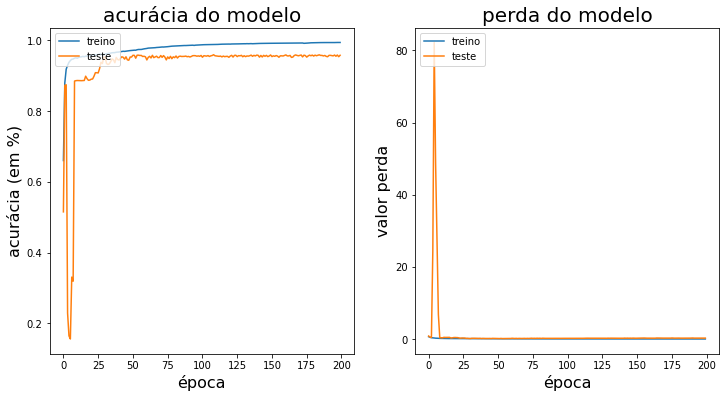

In [9]:
plot_learning_curve(results)
plt.show()

In [10]:
# Predict on train, val and test
#model = load_model("model.h5")
trainLen = len(X_train)
preds_train = model.predict(X_train[:trainLen - 2], verbose=1)
preds_test = model.predict(X_train[trainLen - 2:], verbose=1)
preds_val = model.predict(X_test, verbose=1)

# Threshold predictions
preds_train_t = (preds_train > 0.25).astype(np.uint8)
preds_test_t = (preds_test > 0.25).astype(np.uint8)
preds_val_t = (preds_val > 0.25).astype(np.uint8)

1/1 [==============================] - 8s 8s/step


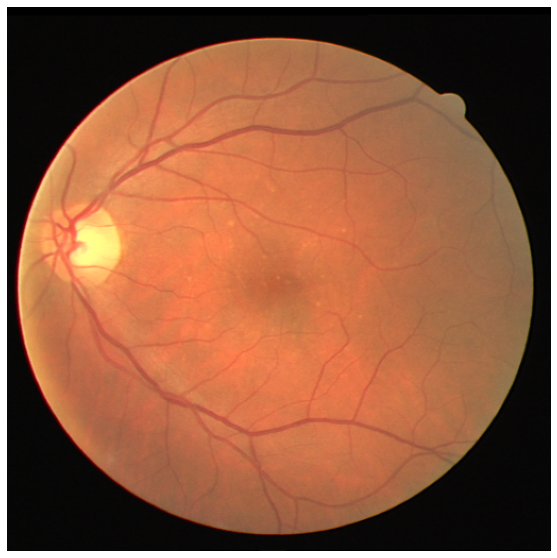

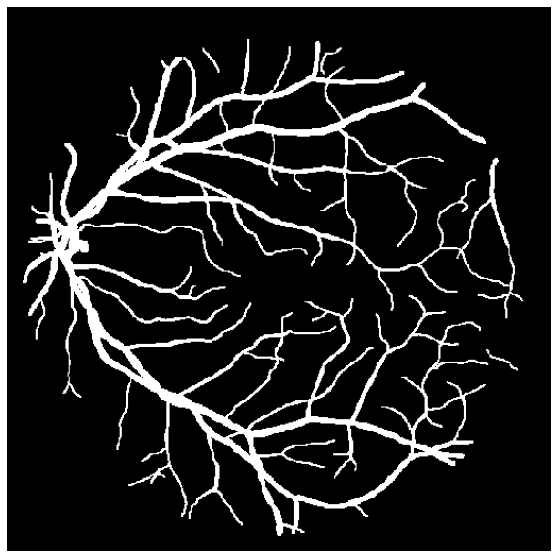

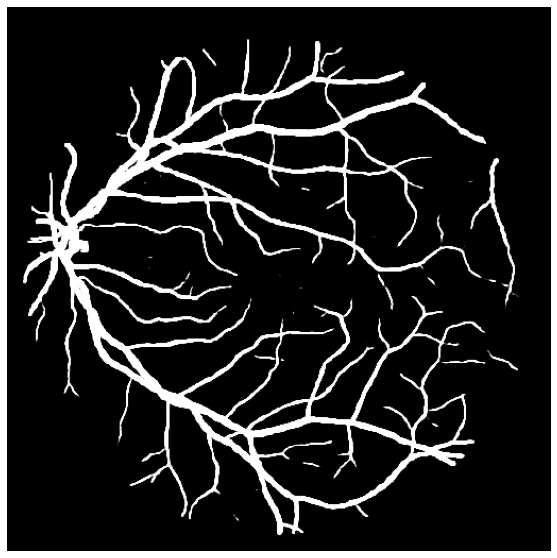

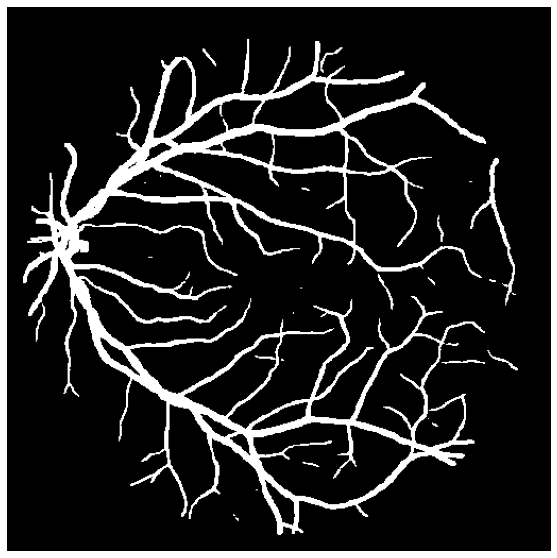

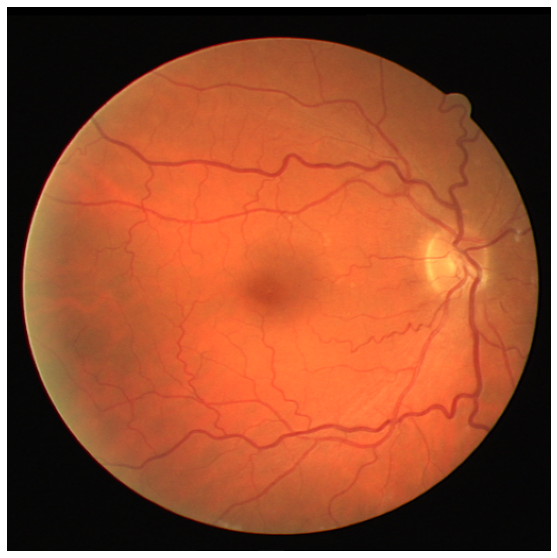

...

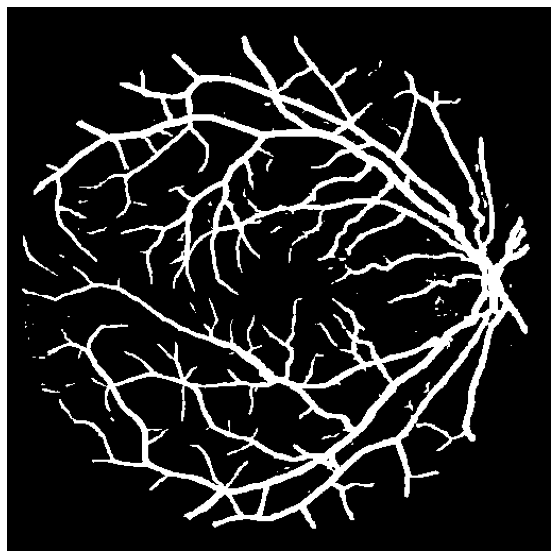

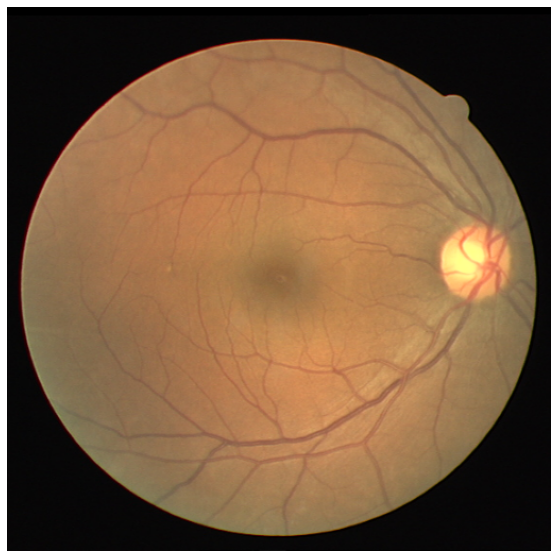

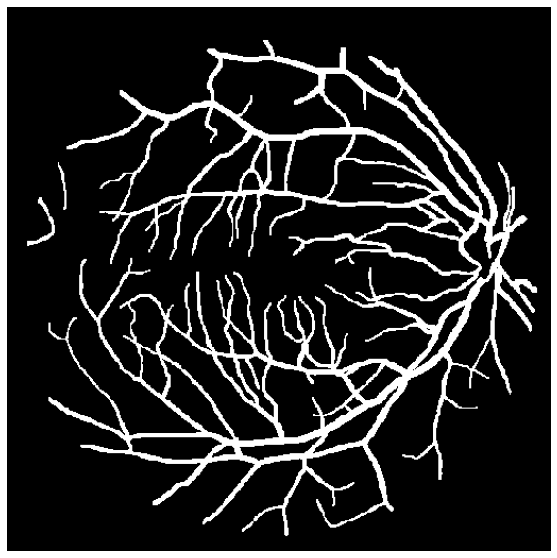

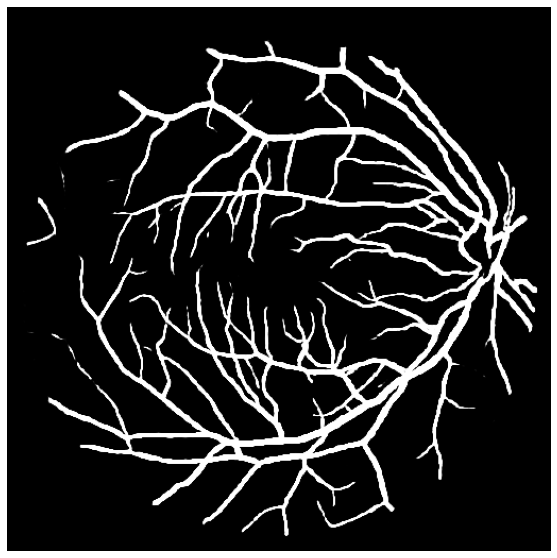

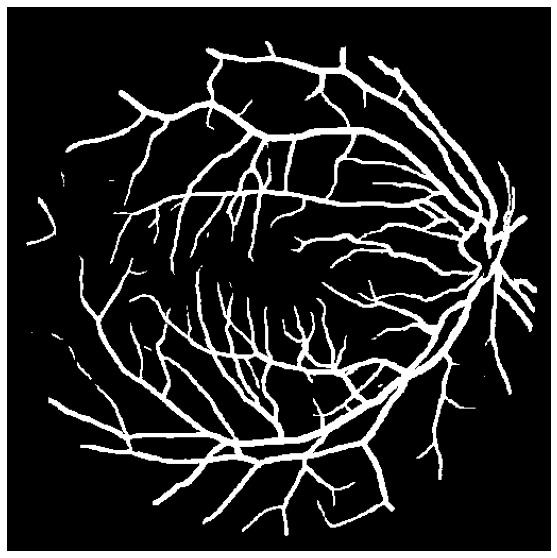

In [11]:
lastIndex = 0

for i in range(0, len(preds_train)):

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(X_train[i])
    plt.savefig("./ResultadosImages/Treino/FigTreino{}.png".format(i))
    plt.show()
    
    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(Y_train[i], cmap=plt.cm.gray)
    plt.savefig("./ResultadosImages/Treino/FigUnetDriveTreinoOriginal{}.png".format(i))
    plt.show()

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(preds_train[i], cmap=plt.cm.gray)
    plt.savefig("./ResultadosImages/Treino/FigUnetDrivePredTreino{}.png".format(i))
    plt.show()

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(preds_train_t[i], cmap=plt.cm.gray)
    plt.savefig("./ResultadosImages/Treino/FigUnetDrivePredTreshiTreino{}.png".format(i))
    plt.show()
    
    lastIndex = i

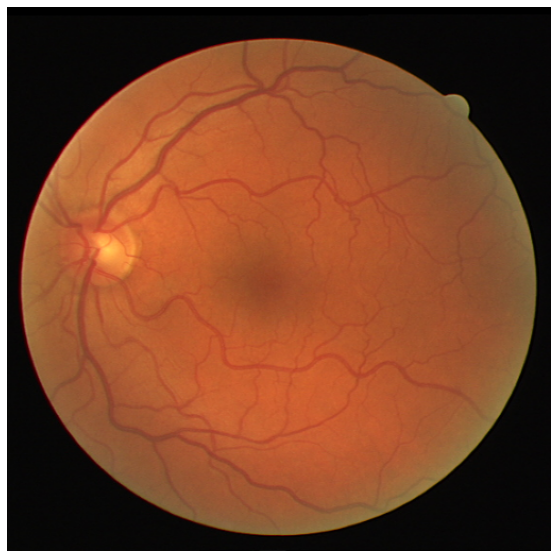

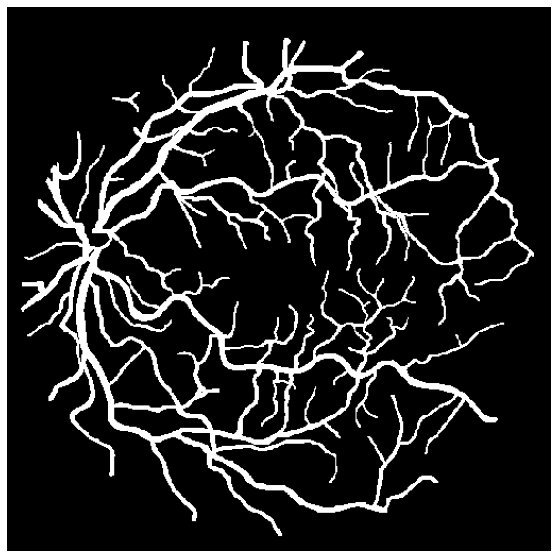

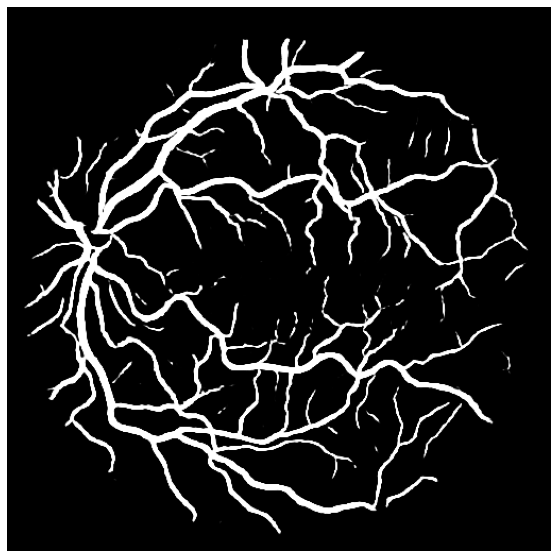

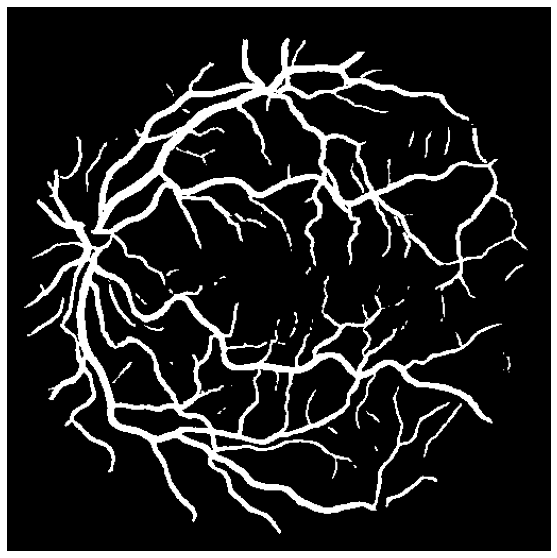

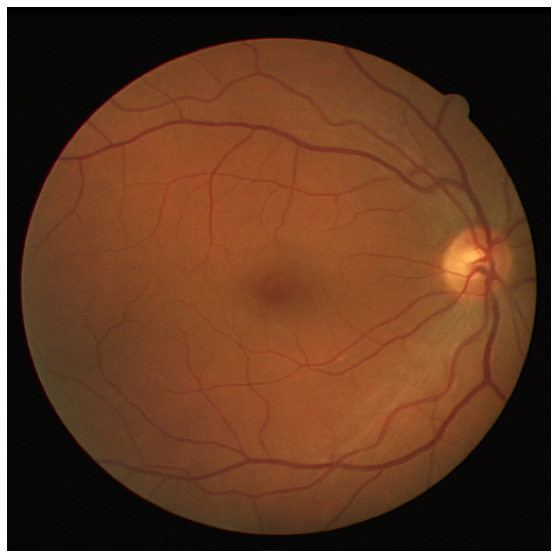

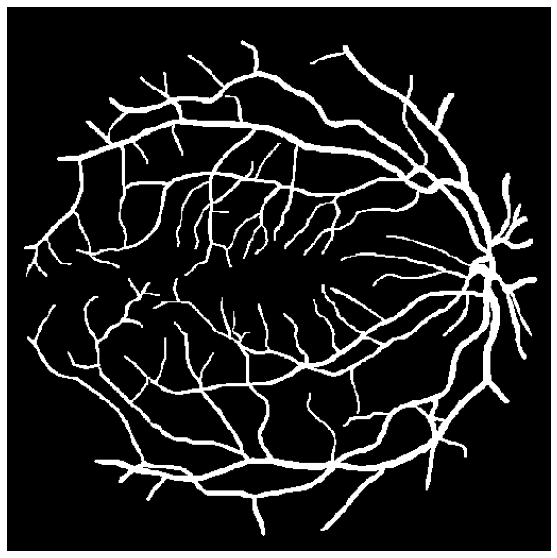

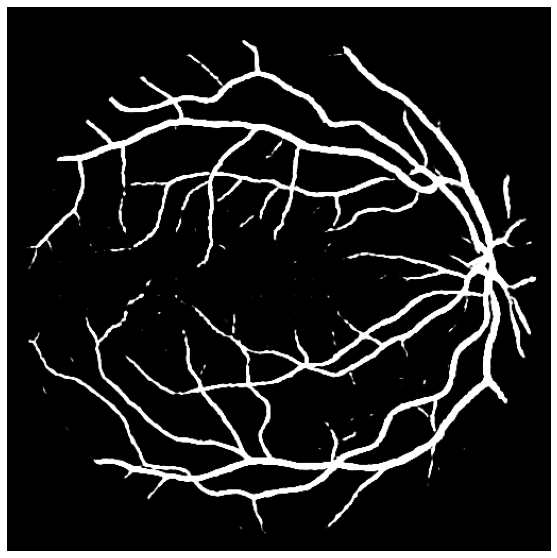

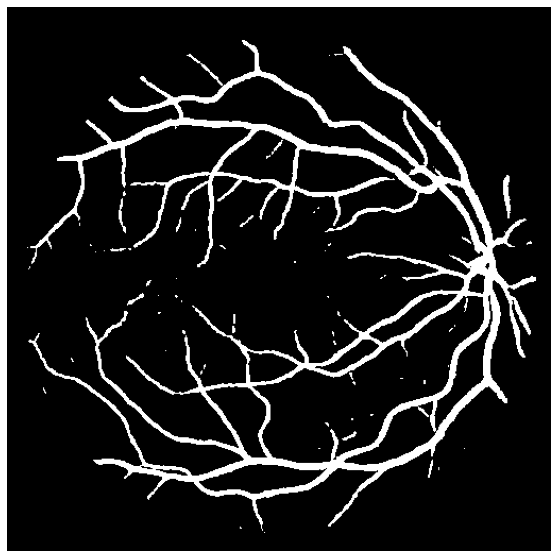

In [12]:
for i in range(0, len(preds_test)):

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(X_train[lastIndex + i + 1])
    plt.savefig("./ResultadosImages/Teste/FigTeste{}.png".format(lastIndex + i + 1))
    plt.show()

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(Y_train[lastIndex + i + 1], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Teste/FigUnetDriveTesteOriginal{}.png".format(lastIndex + i + 1))
    plt.show()

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(preds_test[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Teste/FigUnetDriveTeste{}.png".format(i))
    plt.show()

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(preds_test_t[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Teste/FigUnetDriveTreshiTeste{}.png".format(i))
    plt.show()

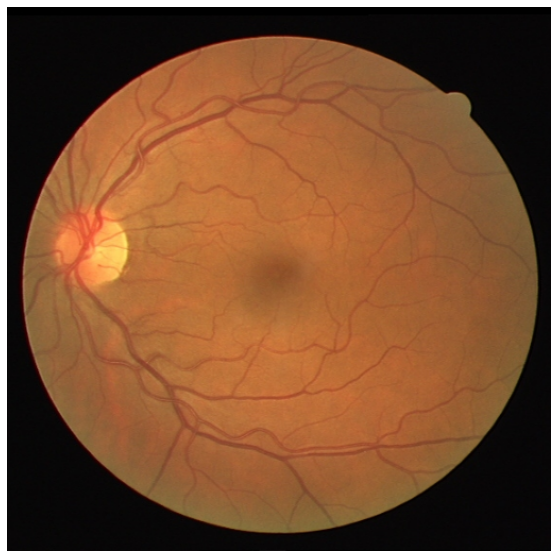

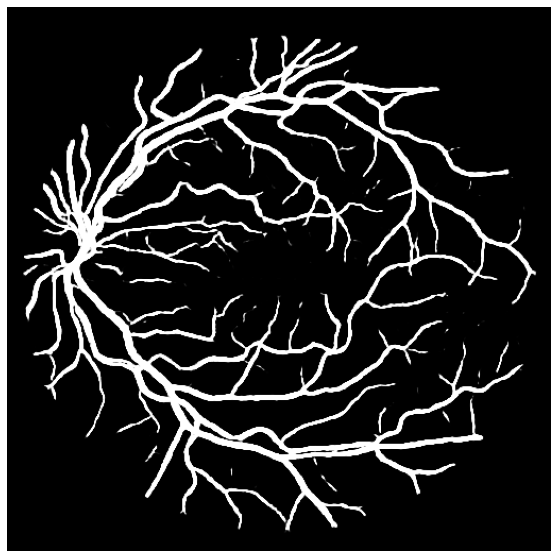

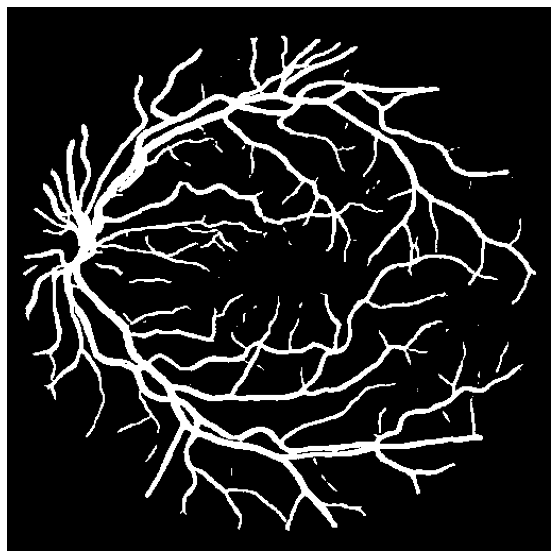

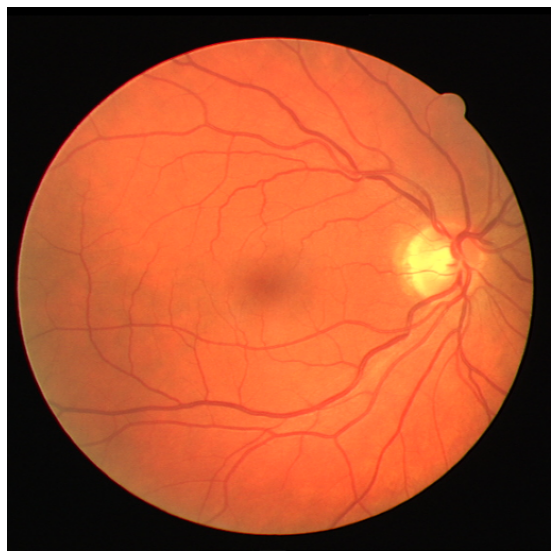

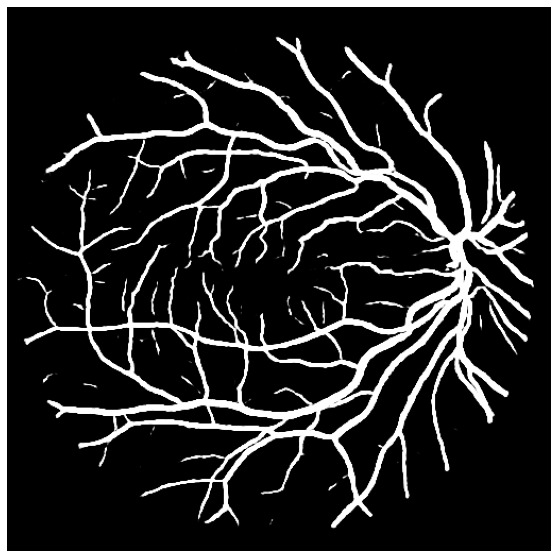

...

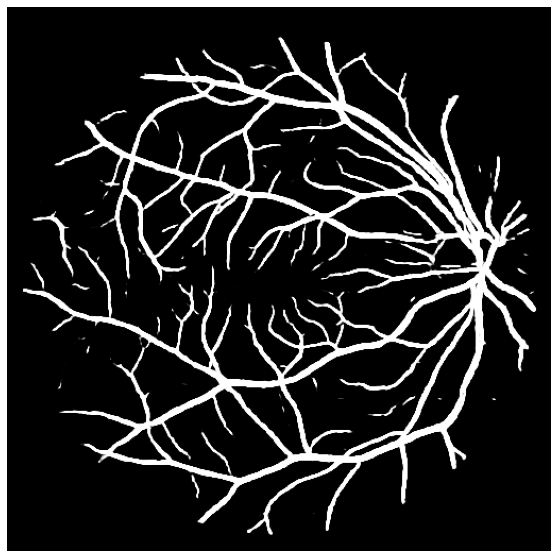

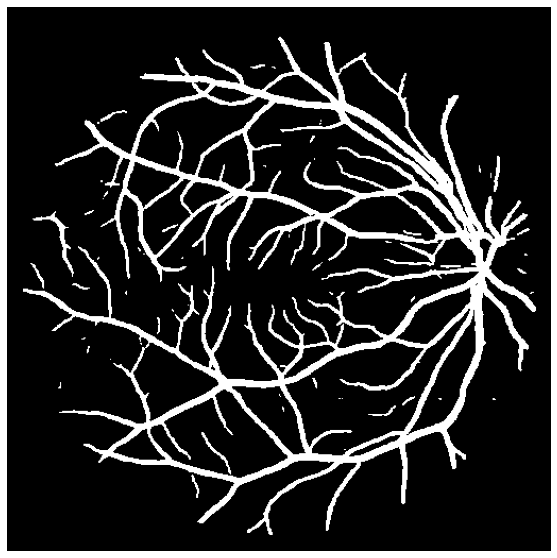

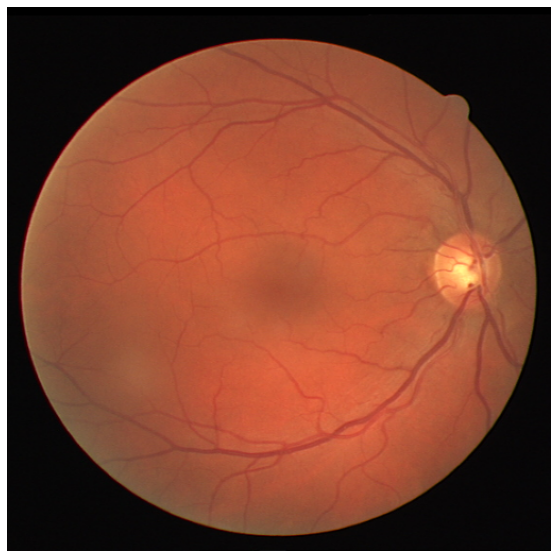

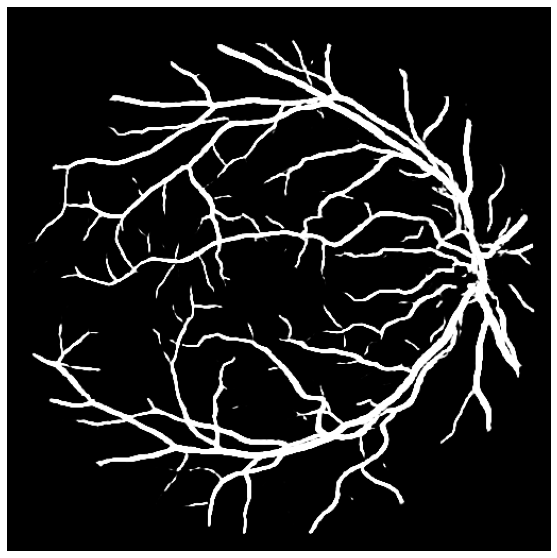

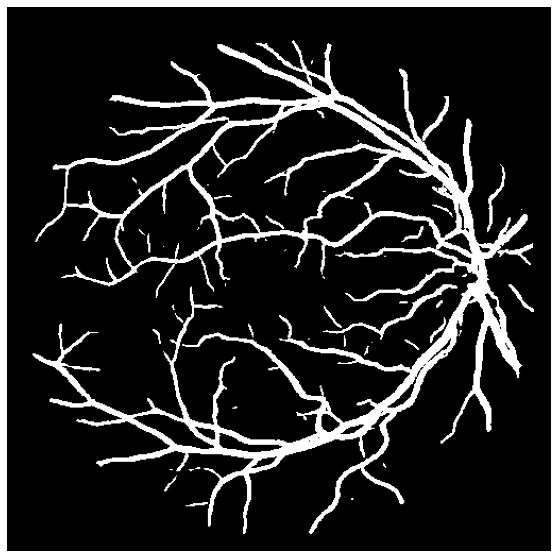

In [13]:
for i in range(0, len(preds_val)):

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(X_test[i])
    plt.savefig("./ResultadosImages/Validacao/FigValid{}.png".format(i))
    plt.show()

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(preds_val[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Validacao/FigUnetDrivePredValid{}.png".format(i))
    plt.show()

    plt.figure(figsize=(10,10))
    plt.axis("off")
    plt.imshow(preds_val_t[i], cmap = plt.cm.gray)
    plt.savefig("./ResultadosImages/Validacao/FigUnetDrivePredTreshiValid{}.png".format(i))
    plt.show()